### Spatial mapping of human lung region snRNA-seq to Visium FFPE (for Elo) - withnon-amortised inference

In [1]:
import sys
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/BayraktarLab/cell2location/')

import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib as mpl

#import cell2location
import scvi

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns

Global seed set to 0


`THEANO_FLAGS='force_device=True'` forces the package to use GPU. Pay attention to error messages that might indicate theano failed to initalise the GPU.   
Do not forget to change `device=cuda4` to your available GPU id. Use `device=cuda` / `device=cuda0` if you have just one locally or if you are requesting one GPU via HPC cluster job.

### Outline

1. Loading Visium data and single cell reference
2. Show UMAP of cells and locations
3. cell2location analysis in one step
4. Automatic discrete region identification by clustering cell densities
5. Visualize cell type density gradients using diffusion maps
6. Identify co-occuring cell type combinations using matrix factorisation



## 1. Loading Visium data and single cell reference

First let's read spatial Visium data from 10X Space Ranger output. Here we load sample annotations.

In [2]:
#sp_data_folder = '/nfs/team205/vk7/sanger_projects/large_data/lung_airway_km/regions_with_visium_all/'
sp_data_folder = '/lustre/scratch117/cellgen/team205/sharedData/em17/visium-ffpe/'
sc_data_folder = '/nfs/team205/vk7/sanger_projects/large_data/lung_airway_km/'
results_folder = '/nfs/team205/vk7/sanger_projects/collaborations/adult_lung_mapping/results/'
gut_results_folder = '/nfs/team205/vk7/sanger_projects/collaborations/fetal_gut_mapping/results/'
scvi_ref_run_name = f'{results_folder}/non_amortised/v0_Adam_4000iter_snsc_selection_CCLplasma_v4Ref'
scvi_gut_ref_run_name = f'{gut_results_folder}regression_model/v1_ye_signatures_lr0002_Adam'

scvi_run_name = f'{results_folder}/non_amortised/v4_nonamortised_Adam_alpha20_40k_lr0002_CCLplasma_long_v4Ref_wo_lowQ_scaledELBO_VisiumFFPE'

annotation_folder = '/nfs/team205/vk7/sanger_projects/collaborations/adult_lung_mapping/data/Loupe_annotations_FFPE/'

sample_name = pd.Series(['WSA_LngSP10972072', 'WSA_LngSP10972073', 'WSA_LngSP10972074', 'WSA_LngSP10972075', 
                        ])

Next we load the mRNA count for each Visium slide and corresponding histology images as a list `slides` and as a single anndata object `adata`. We need this redundancy because scanpy plotting over the histology image does not work with multiple sections.   

In [3]:
def read_and_qc(sample_name, path=sp_data_folder + ''):
    
    adata = sc.read_visium(path + str(sample_name) + '/outs/',
                           count_file='filtered_feature_bc_matrix.h5', load_images=True)
    adata.obs['sample'] = sample_name
    adata.var['SYMBOL'] = adata.var_names
    adata.var.rename(columns={'gene_ids': 'ENSEMBL'}, inplace=True)
    adata.var_names = adata.var['ENSEMBL']
    adata.var.drop(columns='ENSEMBL', inplace=True)

    # Calculate QC metrics
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    adata.var['mt'] = [gene.startswith('mt-') for gene in adata.var['SYMBOL']]
    adata.obs['mt_frac'] = adata[:, adata.var['mt'].tolist()].X.sum(1).A.squeeze()/adata.obs['total_counts']
    
    # add sample name to obs names
    adata.obs["sample"] = [str(i) for i in adata.obs['sample']]
    adata.obs_names = adata.obs["sample"] \
                          + '_' + adata.obs_names
    adata.obs.index.name = 'spot_id'
    
    return adata

# read first sample
adata = read_and_qc(sample_name[0],
                    path=sp_data_folder + '') 

# read the remaining samples
slides = {}
for i in sample_name[1:]:
    adata_1 = read_and_qc(i, path=sp_data_folder + '') 
    slides[str(i)] = adata_1

adata_0 = adata.copy()
    
# combine individual samples
#adata = adata.concatenate(list(slides.values()), index_unique=None)
adata = adata.concatenate(
    list(slides.values()),
    batch_key="sample",
    uns_merge="unique",
    batch_categories=sample_name, 
    index_unique=None
)

def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """

    slide = adata[adata.obs[s_col].isin([s]), :].copy()
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}

    return slide


slides[str(sample_name[0])] = adata_0

/nfs/team283/vk7/software/miniconda3farm5/envs/test_scvi16_cuda111/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
/nfs/team283/vk7/software/miniconda3farm5/envs/test_scvi16_cuda111/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/nfs/team283/vk7/software/miniconda3farm5/envs/test_scvi16_cuda111/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/nfs/team283/vk7/software/miniconda3farm5/envs/test_scvi16_cuda111/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: 

In [4]:
# read histology-based annotations:
from glob import glob
from re import sub
annotations = []
for s in adata.obs['sample'].unique():
    annotation_files = glob(f'{annotation_folder}{s}/*csv')
    annotation_cols = [sub('^.+/', '', i)for i in annotation_files]
    annotation_cols = [sub('\.csv$', '', i)for i in annotation_cols]
    annotation_cols_clean = [sub(' ', '_', i)for i in annotation_cols]
    annotations = annotations + annotation_cols_clean

    for i, f in enumerate(annotation_files):
        
        annot_ = pd.read_csv(f, index_col='Barcode')
        annot_.index = [f'{s}_{i}' for i in annot_.index]
        
        if annotation_cols_clean[i] not in adata.obs.columns:
            adata.obs[annotation_cols_clean[i]] = ''

        adata.obs.loc[annot_.index, annotation_cols_clean[i]] = annot_[annotation_cols[i]]
    
annotations = np.unique(annotations)
adata.obs['Tissue'].value_counts(dropna=False)#, adata.obs['Weird_morphology'].value_counts(dropna=False), annotations

1.0    7202
       1768
NaN     123
Name: Tissue, dtype: int64

In [5]:
for a in annotations:
    print(adata.obs[a].value_counts(dropna=False))
    adata.obs[a] = ~(adata.obs[a].isna() | (adata.obs[a] == ''))
    print(adata.obs[a].value_counts(dropna=False))

NaN    8798
1.0     295
Name: Airway_smooth_muscle, dtype: int64
False    8798
True      295
Name: Airway_smooth_muscle, dtype: int64
NaN    9056
1.0      37
Name: Arterial_vessel, dtype: int64
False    9056
True       37
Name: Arterial_vessel, dtype: int64
NaN    6503
1.0    2590
Name: Cartilage, dtype: int64
False    6503
True     2590
Name: Cartilage, dtype: int64
NaN    8036
1.0    1057
Name: Glands, dtype: int64
False    8036
True     1057
Name: Glands, dtype: int64
       5939
NaN    2989
1.0     165
Name: Large_vessel, dtype: int64
False    8928
True      165
Name: Large_vessel, dtype: int64
NaN    8964
1.0     129
Name: Mucous_glands, dtype: int64
False    8964
True      129
Name: Mucous_glands, dtype: int64
NaN                       8566
1.0                        318
Create new cluster "1"     209
Name: Multilayer_epithelium, dtype: int64
False    8566
True      527
Name: Multilayer_epithelium, dtype: int64
NaN    4806
       4269
1.0      18
Name: Nerve_bundle, dtype: int64


Now let's look at QC: total number of counts and total number of genes per spot

/nfs/team283/vk7/software/miniconda3farm5/envs/test_scvi16_cuda111/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


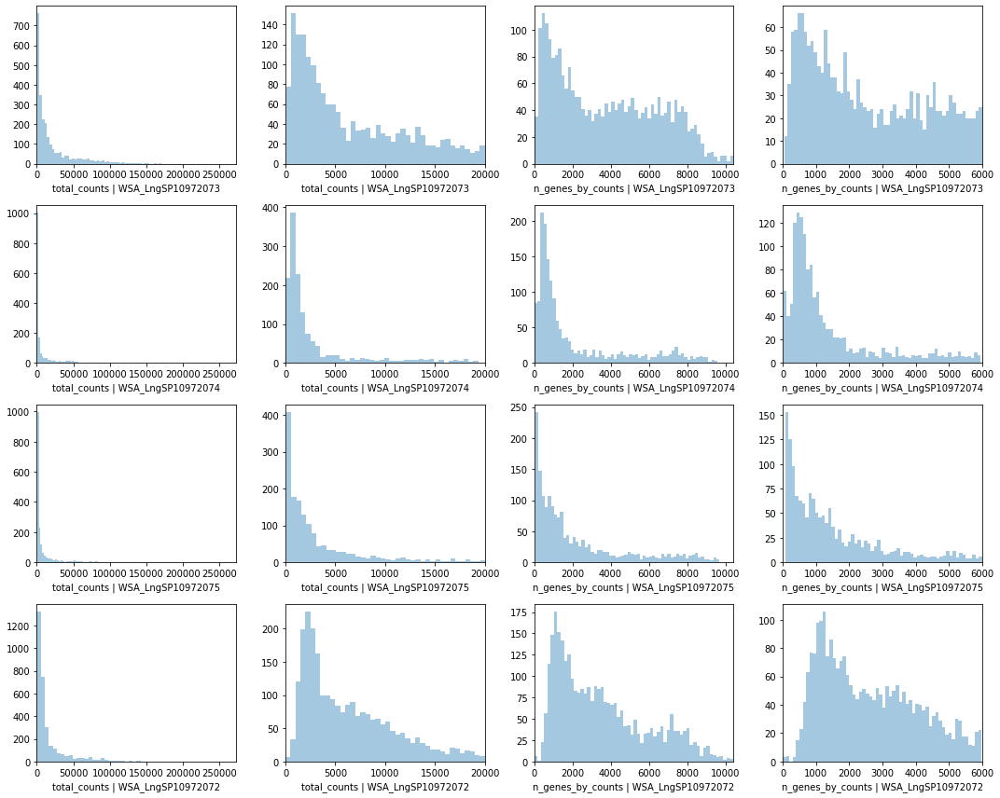

In [6]:
# PLOT QC FOR EACH SAMPLE 
fig, axs = plt.subplots(len(slides), 4, figsize=(15, 4*len(slides)-4))
for i in range(len(slides)):
    #fig.suptitle('Covariates for filtering')
    
    sns.distplot(list(slides.values())[i].obs['total_counts'], 
                 kde=False, ax = axs[i, 0])
    axs[i, 0].set_xlim(0, adata.obs['total_counts'].max())
    axs[i, 0].set_xlabel('total_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['total_counts']\
                 [list(slides.values())[i].obs['total_counts']<20000],
                 kde=False, bins=40, ax = axs[i, 1])
    axs[i, 1].set_xlim(0, 20000)
    axs[i, 1].set_xlabel('total_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['n_genes_by_counts'],
                 kde=False, bins=60, ax = axs[i, 2])
    axs[i, 2].set_xlim(0, adata.obs['n_genes_by_counts'].max())
    axs[i, 2].set_xlabel('n_genes_by_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['n_genes_by_counts']\
                 [list(slides.values())[i].obs['n_genes_by_counts']<6000],
                 kde=False, bins=60, ax = axs[i, 3])
    axs[i, 3].set_xlim(0, 6000)
    axs[i, 3].set_xlabel('n_genes_by_counts | ' + list(slides.keys())[i])
    
    plt.tight_layout()

WSA_LngSP10972072


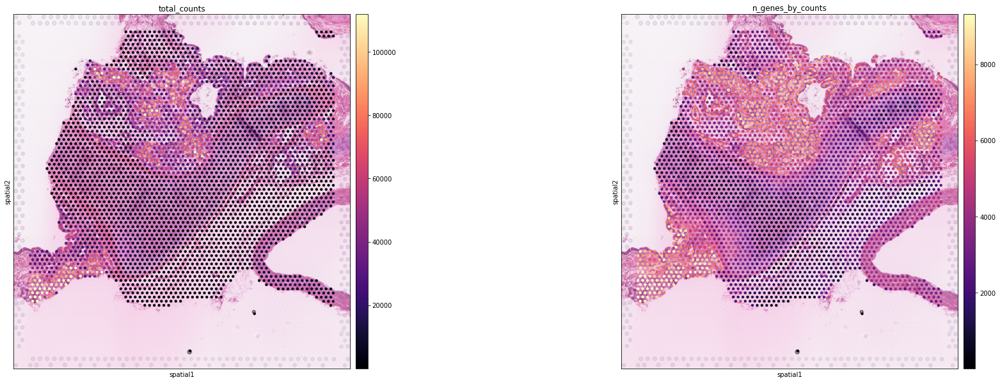

WSA_LngSP10972073


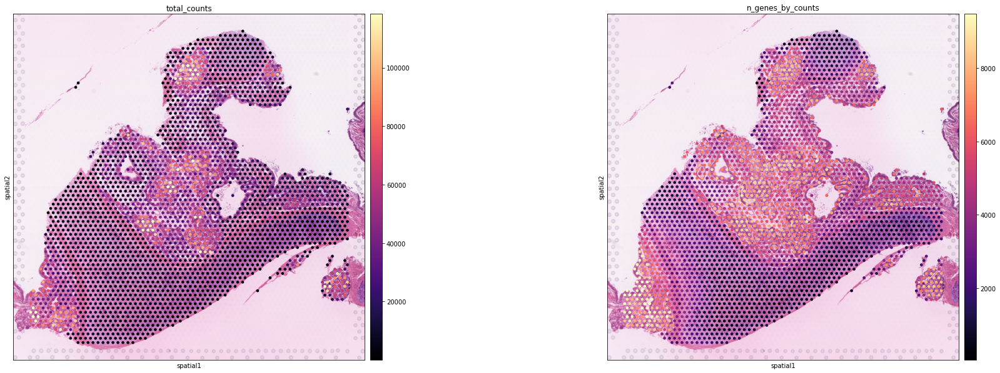

WSA_LngSP10972074


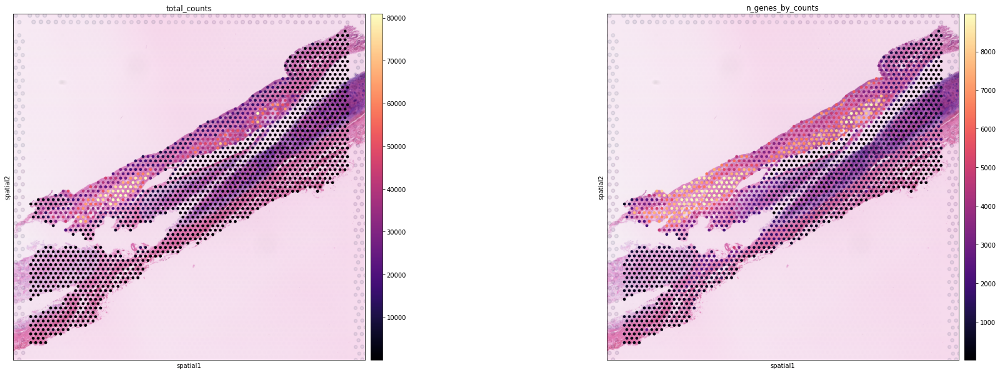

WSA_LngSP10972075


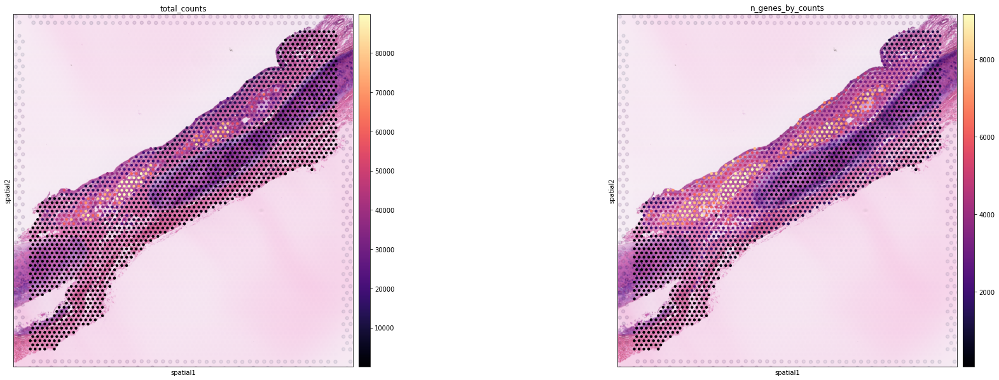

In [7]:
for s in np.unique(adata.obs['sample']):
    slide = select_slide(adata, s)
    print(s)
    with mpl.rc_context({'figure.figsize': (15, 10)}):
        sc.pl.spatial(slide, img_key = "hires", cmap='magma',
                      color=['total_counts', 'n_genes_by_counts'], size=0.9,
                      vmax='p99.0',
                      gene_symbols='SYMBOL')

Here we show how to use scanpy to plot results over histology section using anndata object from one section, and 

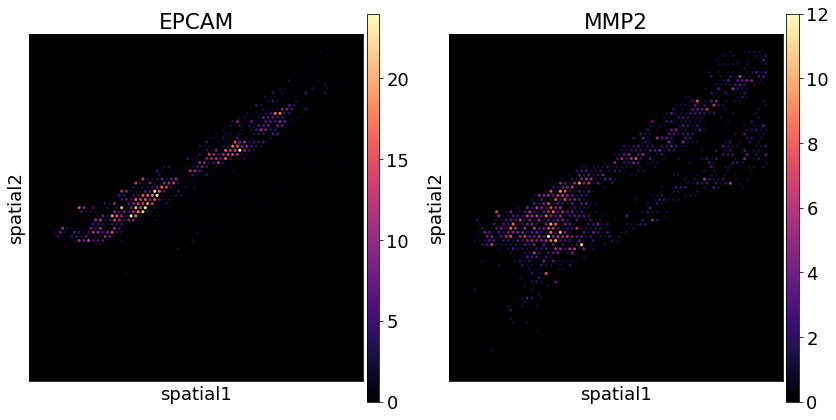

In [8]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [6,7]
rcParams["font.size"] = 18

slide = select_slide(adata, s)
sc.pl.spatial(slide, 
              color=["EPCAM", "MMP2"], img_key=None,
              vmin=0, cmap='magma', #vmax=3.8,
              gene_symbols='SYMBOL'
             )

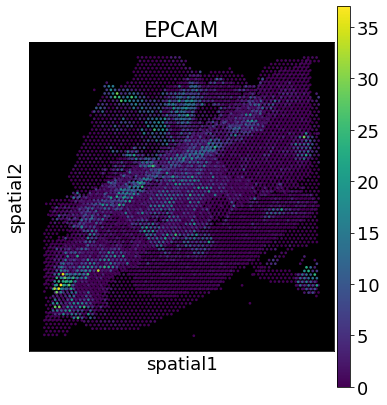

In [9]:
sc.pl.spatial(adata, 
              color=["EPCAM"], img_key=None,
              vmin=0, library_id='WSA_LngSP10972072',
              gene_symbols='SYMBOL'
             )

In [10]:
adata_vis = adata.copy()
#adata_vis.var_names = adata_vis.var['SYMBOL']
#adata_vis.var_names.name = 'index'
adata_vis.raw = adata_vis

## 2. Show UMAP of cells and locations

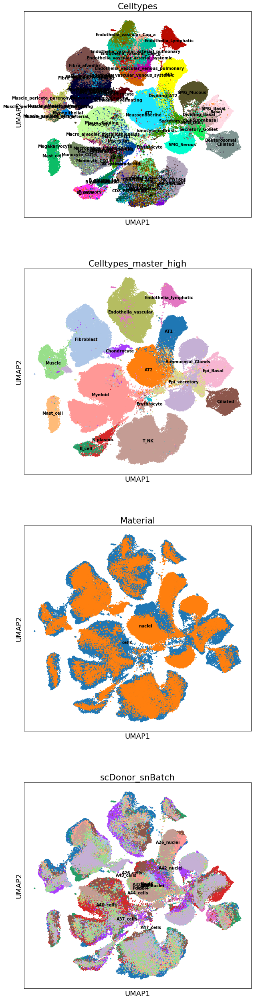

In [11]:
#mod = scvi.external.cell2location.RegressionModel.load(f"{scvi_run_name}_snsc_selection_ref", adata_snrna_raw)
adata_file = f"{scvi_ref_run_name}/sc.h5ad"
adata_snrna_raw = sc.read_h5ad(adata_file)

# export estimated expression in each cluster
if 'means_per_cluster_mu_fg' in adata_snrna_raw.varm.keys():
    inf_aver = adata_snrna_raw.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}' 
                                    for i in adata_snrna_raw.uns['mod']['factor_names']]].copy()
else:
    inf_aver = adata_snrna_raw.var[[f'means_per_cluster_mu_fg_{i}' 
                                    for i in adata_snrna_raw.uns['mod']['factor_names']]].copy()
inf_aver.columns = adata_snrna_raw.uns['mod']['factor_names']
inf_aver.iloc[0:5, 0:5]

rcParams['figure.figsize'] = 10, 10
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_snrna_raw, color=['Celltypes', 'Celltypes_master_high',
                                   'Material', 'scDonor_snBatch'],
           color_map = 'RdPu', ncols = 1, legend_loc='on data',
           size=30,
           legend_fontsize=10)

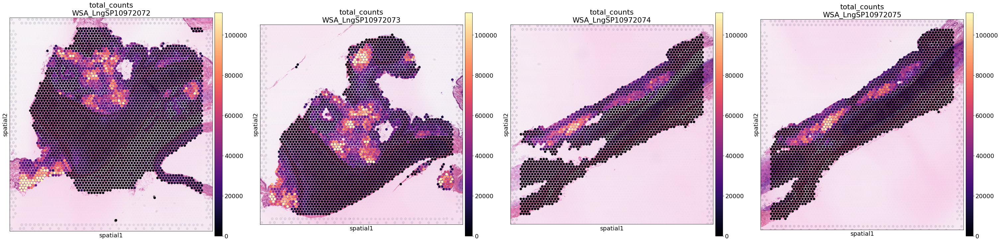

In [12]:
def plot_spatial_per_cell_type(adata, 
                               cell_type='total_counts',
                               samples=[
       'WSA_LngSP10972072', 'WSA_LngSP10972073', 'WSA_LngSP10972074',
                                    
       'WSA_LngSP10972075',
                               ],
                              ncol=4, prefix='', figsize=(42, 10),
                              vmax_quantile=0.992):
    n_samples = len(samples)
    nrow = int(np.ceil(n_samples / ncol))
    fig, axs = plt.subplots(nrow, ncol, figsize=figsize)
    if nrow == 1:
        axs = axs.reshape((1, ncol))
    
    col_name = f'{prefix}{cell_type}'
    vmax = np.quantile(adata_vis.obs[col_name].values, vmax_quantile)
    adata_vis.obs[cell_type] = adata_vis.obs[col_name].copy()
    
    from itertools import chain
    ind = list(chain(*[[(i, j) for i in range(nrow)] for j in range(ncol)]))
    
    for i, s in enumerate(samples):
        sp_data_s = select_slide(adata, s, s_col='sample')
        sc.pl.spatial(sp_data_s, cmap='magma',
                      color=cell_type, 
                      size=1.3, img_key='hires', alpha_img=1,
                      vmin=0, vmax=vmax, ax=axs[ind[i][0],ind[i][1]], show=False
                                            )
        axs[ind[i][0],ind[i][1]].title.set_text(cell_type+'\n'+s)
        
    if len(samples) < len(axs.flatten()):
        for i in range(len(samples), len(axs.flatten())):
            axs[ind[i][0],ind[i][1]].axis('off')
        
    fig.tight_layout(pad=0.5)
        
    return fig

plot_spatial_per_cell_type(adata_vis, cell_type='total_counts');

# 3. cell2location analysis in one step

Here we show how to perform the first step in one function run - train cell2location model to learn cell locations. Results are shown below and saved to:  

In [13]:
results_folder

'/nfs/team205/vk7/sanger_projects/collaborations/adult_lung_mapping/results/'

### Train scvi-cell2location

In [14]:
# find shared genes and subset both anndata and reference signatures
intersect = np.intersect1d(adata_vis.var_names, inf_aver.index)
adata_vis = adata_vis[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()

# prepare anndata for scVI model
import cell2location
cell2location.models.Cell2location.setup_anndata(adata=adata_vis, batch_key="sample")

Anndata setup with scvi-tools version 0.16.0.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 9093  │
│          n_vars          │ 11498 │
│         n_batch          │   4   │
│         n_labels         │   1   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                      batch State Registry                       
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃    Categories     ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │ WSA_LngSP10972072 │          0          │
│                     │ WSA_LngSP10972073 │          1          │
│                     │ WSA_LngSP10972074 │          2          │
│                     │ WSA_LngSP10972075 │          3          │
└─────────────────────┴───────────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/nfs/team283/vk7/software/miniconda3farm5/envs/test_scvi16_cuda111/lib/python3.9/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/nfs/team283/vk7/software/miniconda3farm5/envs/test_scvi16_cuda111/lib/python3.9/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 40000/40000: 100%|█████████████████████████████████████████████████████████| 40000/40000 [1:39:08<00:00,  6.72it/s, v_num=1, elbo_train=0.595]


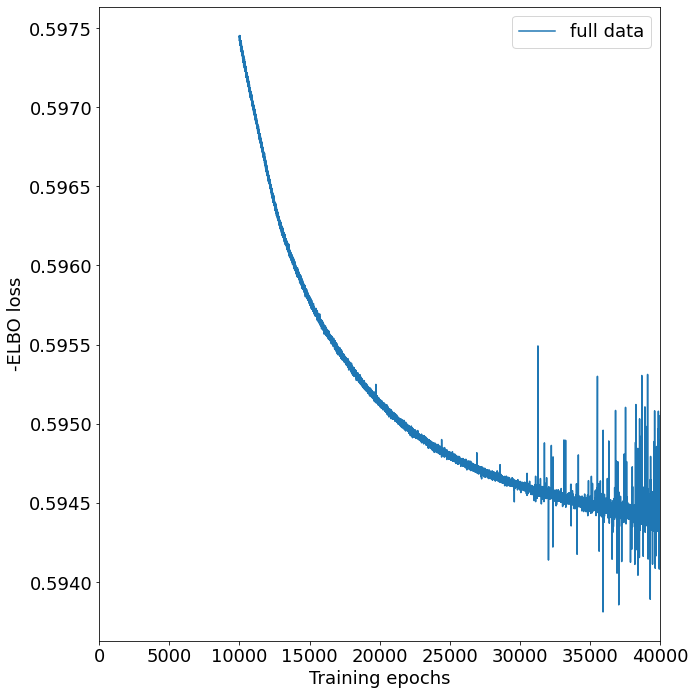

In [15]:
# create and train the model
import pyro
import cell2location
mod = cell2location.models.Cell2location(
    adata_vis, cell_state_df=inf_aver, 
    # model_class=LocationModelLinearDependentWMultiExperimentLocationBackgroundNormLevelGeneAlphaPyroModel,
    amortised=False,# encoder_mode="single-multiple",
    #encoder_kwargs={'dropout_rate': 0.2},
    # the expected average cell abundance - user-provided, tissue-dependent hyper-prior:
    N_cells_per_location=20,
    detection_alpha=20.0,#detection_alpha,
    #detection_hyp_prior={"alpha": 20.0, "mean": 1.0, "mean_alpha": 1.0},
) 

mod.view_anndata_setup()

mod.train(max_epochs=40000, 
          batch_size=None, 
          #plan_kwargs={"optim_kwargs": {"lr": 0.003, "clip_norm": 10}},
          #plan_kwargs={'optim': pyro.optim.ClippedAdam(optim_args={'lr': 0.003, 'clip_norm': 10})},
          plan_kwargs={'optim': pyro.optim.Adam(optim_args={'lr': 0.002})},
          scale_elbo=1 / (adata_vis.n_obs * adata_vis.n_vars),
          train_size=1,
          use_gpu=True)

# plot ELBO loss history during training, removing first 100 epochs from the plot
mod.plot_history(10000)
plt.legend(labels=['full data']);

In [16]:
mod.detection_mean_

0.1131480999878217

In [17]:
# In this section, we export the estimated cell abundance (summary of the posterior distribution).
adata_vis = mod.export_posterior(
    adata_vis, sample_kwargs={'num_samples': 1000, 'batch_size': mod.adata.n_obs, 'use_gpu': True}
)

# Save model
mod.save(f"{scvi_run_name}", overwrite=True)
# can be loaded later like this:
# mod = scvi.external.Cell2location.load(f"{scvi_run_name}", adata_vis)

# Save anndata object with results
adata_file = f"{scvi_run_name}/sp.h5ad"
adata_vis.write(adata_file)
adata_file

Sampling global variables, sample: 100%|██████████████████████████████████████████████████████████████████████████| 999/999 [00:26<00:00, 37.47it/s]


'/nfs/team205/vk7/sanger_projects/collaborations/adult_lung_mapping/results//non_amortised/v4_nonamortised_Adam_alpha20_40k_lr0002_CCLplasma_long_v4Ref_wo_lowQ_scaledELBO_VisiumFFPE/sp.h5ad'

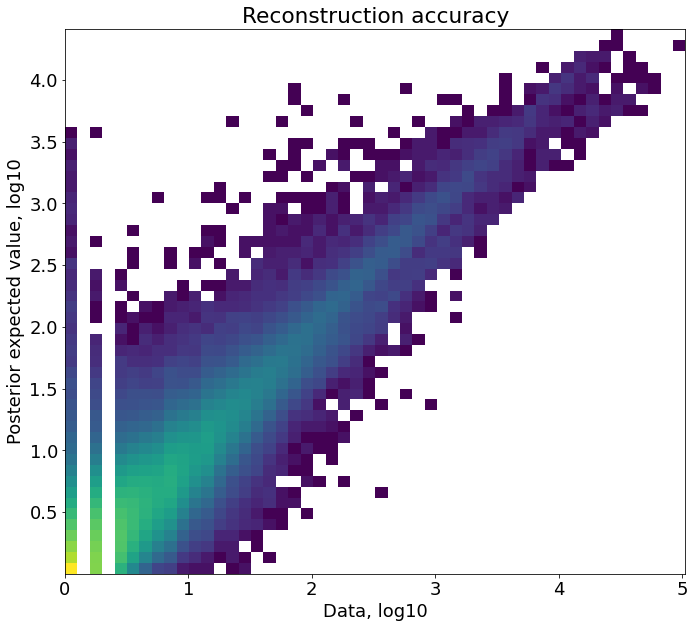

In [18]:
# Examine reconstruction accuracy to assess if there are any issues with mapping
# the plot should be roughly diagonal, strong deviations will signal problems
mod.plot_QC()

In [19]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present', 
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

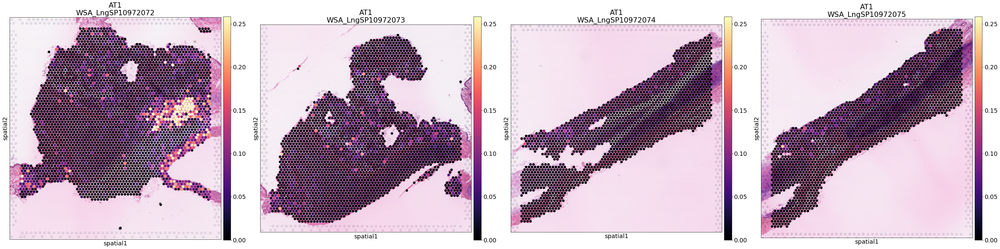

In [20]:
plot_spatial_per_cell_type(adata_vis, cell_type=adata_vis.uns['mod']['factor_names'][0]);

In [21]:
from re import sub
import os
for c in adata_vis.uns['mod']['factor_names']:
    fig = plot_spatial_per_cell_type(adata_vis, cell_type=c)
    fig_dir = f"{scvi_run_name}/spatial/"
    if not os.path.exists(fig_dir):
        os.mkdir(fig_dir)
    fig_dir = f"{scvi_run_name}/spatial/per_cell_type/"
    if not os.path.exists(fig_dir):
        os.mkdir(fig_dir)
    fig.savefig(f"{fig_dir}W_cell_abundance_q05_{sub('/', '_', c)}.png",
                bbox_inches='tight')
    fig.clear()
    plt.close(fig)

f"{scvi_run_name}/spatial/per_cell_type/"


'/nfs/team205/vk7/sanger_projects/collaborations/adult_lung_mapping/results//non_amortised/v4_nonamortised_Adam_alpha20_40k_lr0002_CCLplasma_long_v4Ref_wo_lowQ_scaledELBO_VisiumFFPE/spatial/per_cell_type/'

In [22]:
from re import sub
import os
for c in adata_vis.uns['mod']['factor_names']:
    fig = plot_spatial_per_cell_type(adata_vis, cell_type=c, vmax_quantile=0.9999)
    fig_dir = f"{scvi_run_name}/spatial/"
    if not os.path.exists(fig_dir):
        os.mkdir(fig_dir)
    fig_dir = f"{scvi_run_name}/spatial/per_cell_type/"
    if not os.path.exists(fig_dir):
        os.mkdir(fig_dir)
    fig.savefig(f"{fig_dir}W_cell_abundance_q05_{sub('/', '_', c)}_p9999.png",
                bbox_inches='tight')
    fig.clear()
    plt.close(fig)

f"{scvi_run_name}/spatial/per_cell_type/"


'/nfs/team205/vk7/sanger_projects/collaborations/adult_lung_mapping/results//non_amortised/v4_nonamortised_Adam_alpha20_40k_lr0002_CCLplasma_long_v4Ref_wo_lowQ_scaledELBO_VisiumFFPE/spatial/per_cell_type/'

In [23]:
with mpl.rc_context({"axes.facecolor": "black"}):
    clust_names = adata_vis.uns['mod']['factor_names']
    
    for s in adata_vis.obs['sample'].unique():

        s_ind = adata_vis.obs['sample'] == s
        s_keys = list(adata_vis.uns['spatial'].keys())
        s_spatial = np.array(s_keys)[[s in i for i in s_keys]][0]

        fig = sc.pl.spatial(adata_vis[s_ind, :], cmap='magma',
                            color=clust_names, ncols=5, library_id=s_spatial,
                            size=1.3, img_key='hires', alpha_img=1,
                            vmin=0, vmax='p99.2',
                            return_fig=True, show=False)
        
        fig_dir = f"{scvi_run_name}/spatial/"
        if not os.path.exists(fig_dir):
            os.mkdir(fig_dir)
        fig_dir = f"{scvi_run_name}/spatial/per_sample/"
        if not os.path.exists(fig_dir):
            os.mkdir(fig_dir)

        plt.savefig(f"{fig_dir}W_cell_abundance_q05_{s}.png",
                    bbox_inches='tight')
        plt.close()

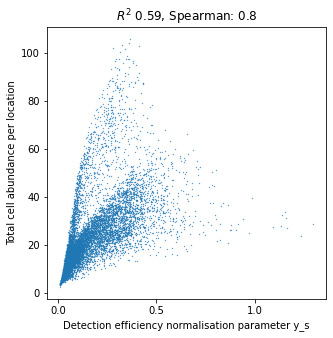

In [24]:
# compare this parameter to nUMI 
with mpl.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                            'figure.figsize': [5, 5]}):
    detection_eff_y_s = adata_vis.uns['mod']['post_sample_means']['detection_y_s'].flatten()
    total_UMI = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1)
    cor = np.corrcoef(detection_eff_y_s, total_UMI)[0, 1]
    from scipy.stats import spearmanr
    cor_spearmanr = spearmanr(detection_eff_y_s, total_UMI)
    
    plt.scatter(detection_eff_y_s, total_UMI,
                s=0.1);
    plt.xlabel('Detection efficiency normalisation parameter y_s');
    plt.ylabel('Total cell abundance per location');
    plt.title(f'$R^2$ {np.round(cor, 2)}, Spearman: {np.round(np.array(cor_spearmanr)[0], 2)}')

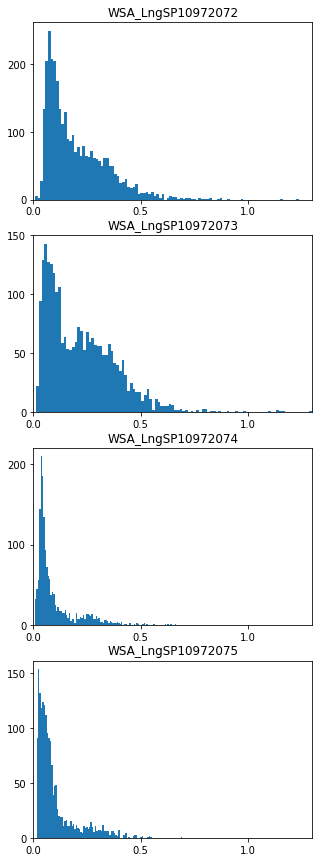

In [25]:
# look at the location detection efficiency parameter for each experiment
with mpl.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                            'figure.figsize': [5, 15]}):
    for i, n in enumerate(adata_vis.obs['sample'].unique()):
        plt.subplot(len(adata_vis.obs['sample'].unique()), 1, i+1)
        x = adata_vis.uns['mod']['post_sample_means']['detection_y_s'].flatten()
        x = x[adata_vis.obs['sample'] == n]
        plt.hist(x, bins=100);
        plt.title(n)
        plt.xlim(0, adata_vis.uns['mod']['post_sample_means']['detection_y_s'].max())

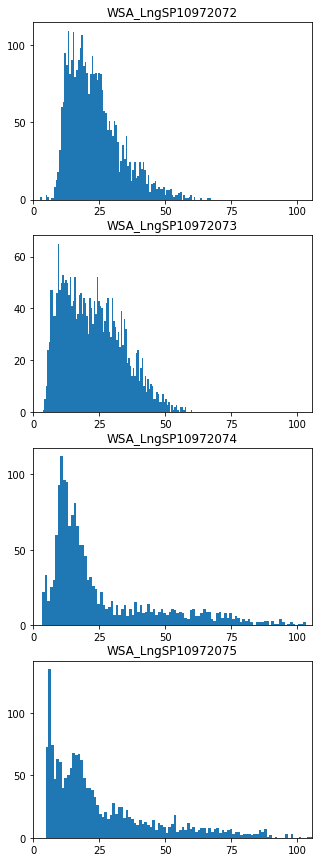

In [26]:
# look at the total cell abundance for each experiment
with mpl.rc_context({'axes.facecolor': 'white', 'font.size': 10, 
                            'figure.figsize': [5, 15]}):
    for i, n in enumerate(adata_vis.obs['sample'].unique()):
        plt.subplot(len(adata_vis.obs['sample'].unique()), 1, i+1)
        total_cell_abundance = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1).flatten()
        total_cell_abundance_ = total_cell_abundance[adata_vis.obs['sample'] == n]
        plt.hist(total_cell_abundance_, bins=100);
        plt.title(n)
        plt.xlim(0, total_cell_abundance.max())

In [27]:
#adata_vis.uns['mod']['post_sample_means']['m_g_mean'], 
adata_vis.uns['mod']['post_sample_means']['m_g'].mean()

0.25929302

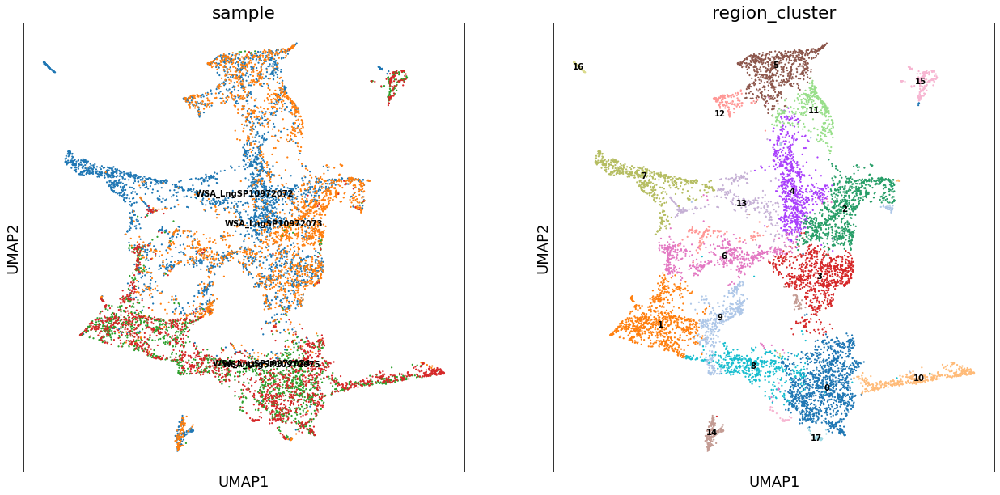

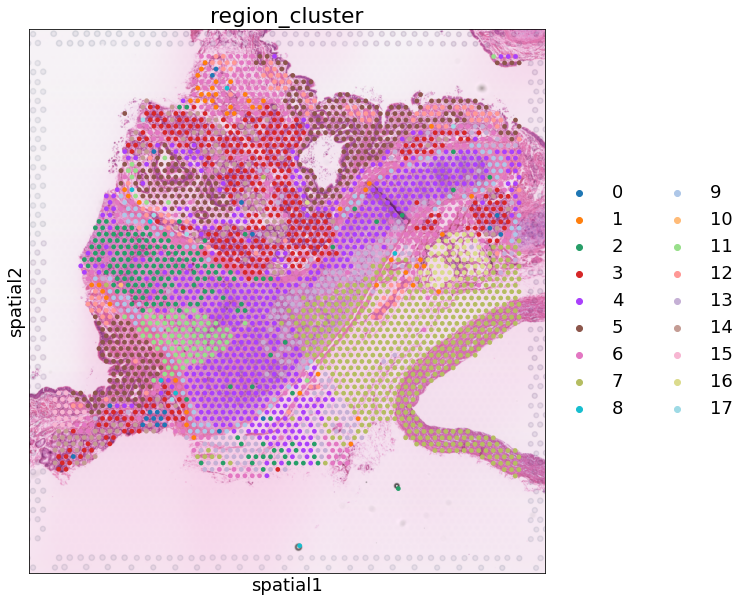

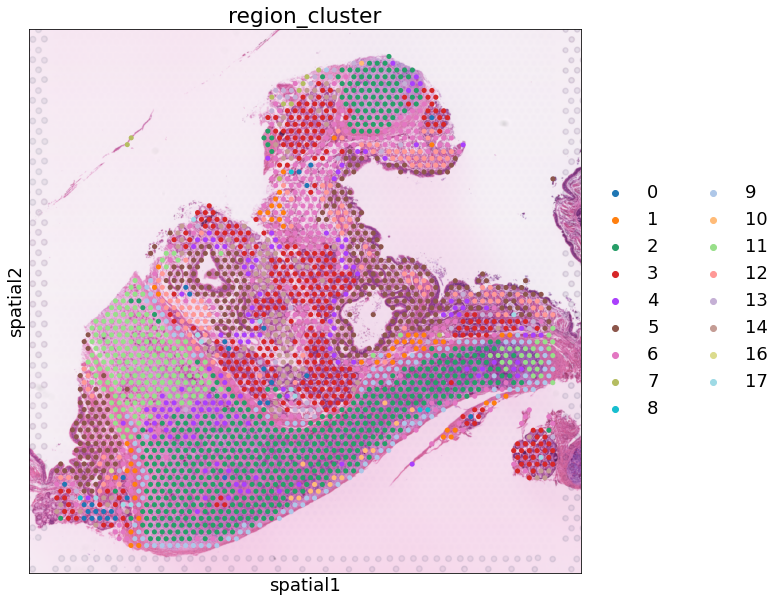

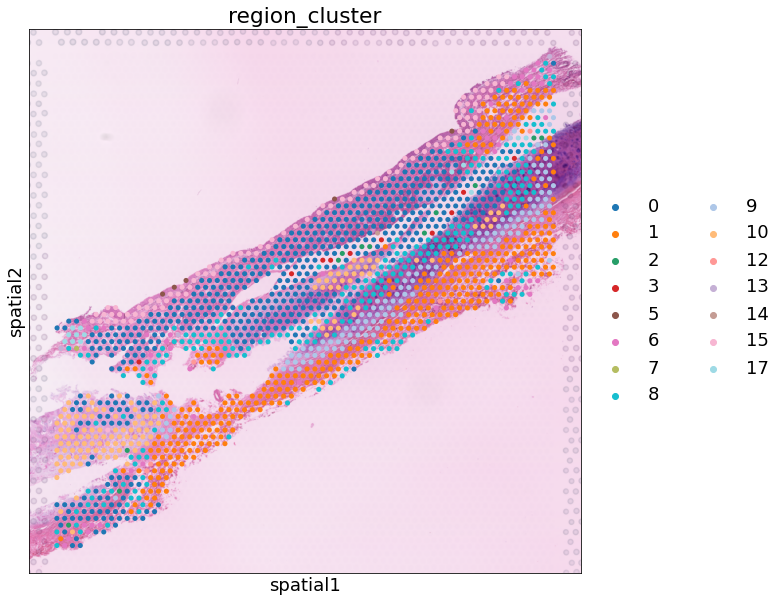

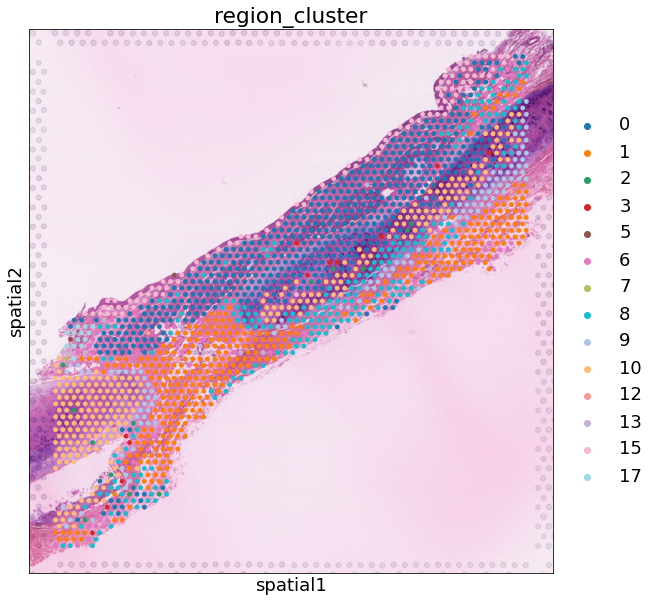

In [28]:
# compute KNN using the cell2location output
sc.pp.neighbors(adata_vis, use_rep='q05_cell_abundance_w_sf',
                n_neighbors = 20, metric='correlation')

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_vis, resolution=0.7)

adata_vis.obs["region_cluster"] = adata_vis.obs["leiden"]
adata_vis.obs["region_cluster"] = adata_vis.obs["region_cluster"].astype("category")


sc.tl.umap(adata_vis, min_dist = 0.2, spread = 1.5)

sc.settings.figdir = f"{scvi_run_name}/"

#del adata_vis.uns['region_cluster_colors']

rcParams['figure.figsize'] = 10, 10
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_vis, color=['sample', 'region_cluster'],
           color_map = 'RdPu', ncols = 2, legend_loc='on data',
           legend_fontsize=10, size=20, save='umap_region_cluster.pdf')

# Plot locations of clusters
rcParams["figure.figsize"] = [10, 10]
rcParams["axes.facecolor"] = "white"

for s in list(adata_vis.obs["sample"].unique()):
    slide = select_slide(adata_vis, s)
    sel_clust = adata_vis.obs['region_cluster'].cat.categories.isin(slide.obs['region_cluster'].cat.categories)
    slide.uns['region_cluster_colors'] = list(np.array(adata_vis.uns['region_cluster_colors'])[sel_clust])
    sc.pl.spatial(slide, #library_id=s,
                  color=["region_cluster"], img_key='hires', size=1,
                  #palette=adata_vis.uns['region_cluster_colors']
                );

### Export regions for import to 10X Loupe Browser
# add binary labels for each region
region_cluster_bin = adata_vis.obs[['region_cluster']]
# save maps for each sample separately
sam = np.array(adata_vis.obs['sample'])

for i in np.unique(sam):
    
    s1 = region_cluster_bin
    s1 = s1.loc[sam == i]
    s1.index = [x[10:] for x in s1.index]
    s1.index.name = 'Barcode'
    
    s1.to_csv(f"{scvi_run_name}/"\
              +'/region_cluster29_' + i + '.csv')

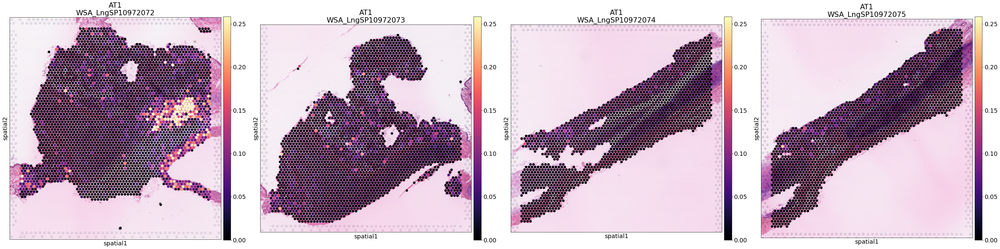

In [29]:
plot_spatial_per_cell_type(adata_vis, cell_type=adata_vis.uns['mod']['factor_names'][0]);

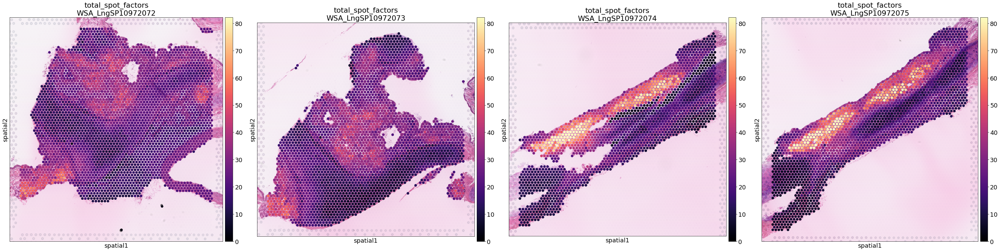

In [30]:
adata_vis.obs['total_spot_factors'] = adata_vis.uns['mod']['post_sample_means']['w_sf'].sum(1).flatten()
plot_spatial_per_cell_type(adata_vis, cell_type='total_spot_factors', prefix='');

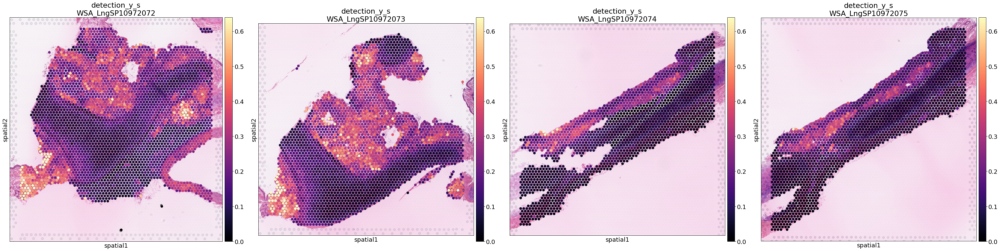

In [31]:
adata_vis.obs['detection_y_s'] = adata_vis.uns['mod']['post_sample_q05']['detection_y_s']
plot_spatial_per_cell_type(adata_vis, cell_type='detection_y_s', prefix='');

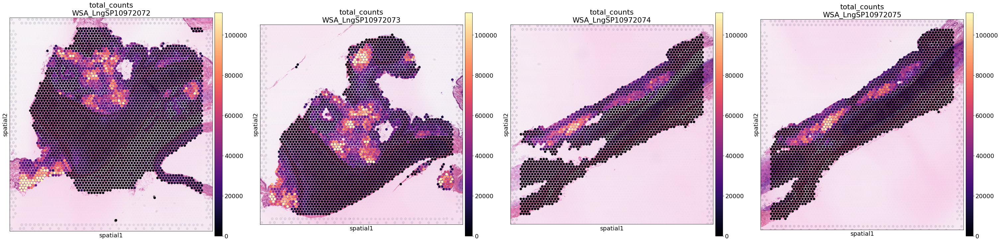

In [32]:
plot_spatial_per_cell_type(adata_vis, cell_type='total_counts', prefix='');

Modules and their versions used for this analysis

In [33]:
import sys
for module in sys.modules:
    try:
        print(module,sys.modules[module].__version__)
    except:
        try:
            if  type(modules[module].version) is str:
                print(module,sys.modules[module].version)
            else:
                print(module,sys.modules[module].version())
        except:
            try:
                print(module,sys.modules[module].VERSION)
            except:
                pass

re 2.2.1
ipykernel._version 6.13.0
json 2.0.9
jupyter_client._version 7.2.2
traitlets._version 5.1.1
traitlets 5.1.1
logging 0.5.1.2
platform 1.0.8
_ctypes 1.1.0
ctypes 1.1.0
zmq.backend.cython.constants 40304
zmq.backend.cython 40304
zmq.sugar.constants 40304
zmq.sugar.version 22.3.0
zmq.sugar 22.3.0
zmq 22.3.0
argparse 1.1
zlib 1.0
_curses b'2.2'
dateutil 2.8.2
six 1.15.0
_decimal 1.70
decimal 1.70
jupyter_core.version 4.10.0
jupyter_core 4.10.0
entrypoints 0.4
jupyter_client 7.2.2
ipykernel 6.13.0
IPython.core.release 8.2.0
executing.version 0.8.3
executing 0.8.3
pure_eval.version 0.2.2
pure_eval 0.2.2
stack_data.version 0.2.0
stack_data 0.2.0
pygments 2.11.2
ptyprocess 0.7.0
pexpect 4.8.0
pickleshare 0.7.5
backcall 0.2.0
decorator 5.1.1
wcwidth 0.2.5
prompt_toolkit 3.0.29
parso 0.8.3
jedi 0.18.1
urllib.request 3.9
IPython 8.2.0
psutil 5.9.0
debugpy 1.6.0
xmlrpc.client 3.9
socketserver 0.4
http.server 0.6
pkg_resources._vendor.appdirs 1.4.3
pkg_resources.extern.appdirs 1.4.3
pkg_res